# Welcome!
# Step 1 - Collect Good Data for training

This notebook walks you through the steps to prepare a dataset for training your own object detection model in Amazon SageMaker using Amazon SageMaker Ground Truth and a series of Python scripts which: 

1. Extracts frames from video and uploads to s3
1. Generates SageMaker Ground Truth Labeling manifest
1. Visualize the SageMaker Ground Truth labeling job manifest
1. Submit Ground Truth labeling job.

### Note
This Jupyer notebook assumes you have already cloned the Git [repo](https://github.com/RaleighSF/amazon-sagemaker-aws-greengrass-custom-object-detection-model) to your SageMaker notebook instance and that you have arrived at this notebook either from the intro notebook or from the cloned directory at (`/home/ec2-user/SageMaker/amazon-sagemaker-aws-greengrass-custom-object-detection-model/data-prep`)

## Setup

Before we get started, install python dependencies - (may take a few mins if first time)

In [1]:
!pip install -r ./requirements.txt


     |████████████████████████████████| 28.2MB 11.4MB/s eta 0:00:01
You should consider upgrading via the 'pip install --upgrade pip' command.


Create a `tmp/` working directory

In [2]:
WORKING_DIR='tmp/'

In [3]:
!mkdir $WORKING_DIR # Create a working directory of where the frames will be stored 

Designate a previously created s3 bucket in your AWS account for storing outputs

In [3]:
OUTPUT_S3_BUCKET = 'cvml-sagemaker-repo'

## Fill the bucket with desired content
You're here presumably because you want to create a new object detection ML model for a business or recreational purpose. The first step in doing so is to procure clean, random and varied data. That is, ultimately a bunch of images that show the object of interest in different positions/environments. You can certainly visit any image provider (like google images) to search for images of interest and save them in the repository. Often times, a more efficient way to capture the necessary images is to extract them from video. The next couple of sections walks you through how to fill your S3 bucket with images captured from video. 

## Capture video 

If you would like to capture your own video using your laptop and a webcam, you can use run this script on your laptop to help you do so

```
git clone https://github.com/aws-samples/amazon-sagemaker-aws-greengrass-custom-object-detection-model.git
cd amazon-sagemaker-aws-greengrass-custom-object-detection-model/
pip install -r data-prep/requirements.txt
python data-prep/00_get_video.py -n <name-of-video> -c <camera-id>
```

See the help on the script for what the options do: 
```
python data-prep/00_get_video.py -h
```

## Got video?

Now that we have collected one or more videos, individual frames need to be extracted from them so they can be labeled and used for training. Ensure that the IAM role of your SageMaker notebook instance has access to the S3 bucket the video is stored at.

In [80]:
VIDEO_S3_BUCKET = 'cvml-sagemaker-repo'  #  Replace with your own values
VIDEO_S3_KEY = 'raw-video/wakeboarding.mp4'

Running the below script will produce a frame for each frame of video.
(e.g. - a 3 min clip at 30 fps would produce 180x30 = 5400 frames.) 
It's good to have each reference frame at our disposal but we very likely won't label each image. (more on that below)

In [82]:
%run -i ./01_video_to_frame_utils.py --video_s3_bucket $VIDEO_S3_BUCKET --video_s3_key $VIDEO_S3_KEY --working_directory $WORKING_DIR --visualize_sample_rate 3 -o $OUTPUT_S3_BUCKET

INFO:__main__:video to convert: s3://cvml-sagemaker-repo/raw-video/wakeboarding.mp4
INFO:__main__:storing files at: tmp/
INFO:__main__:upload frames to S3: False
INFO:__main__:Will generate visualization for video sampling every 3 seconds and upload to s3://cvml-sagemaker-repo/previews/video/
INFO:__main__:Start processing raw-video/wakeboarding.mp4
INFO:__main__:Frames per second using video.get(cv2.CAP_PROP_FPS) : 25.0
INFO:__main__:created tmp/wakeboarding folder for frames
INFO:__main__:extracted 500 frames. 
INFO:__main__:took     9.2389 seconds to extract 500 frames
INFO:__main__:extracted 1000 frames. 
INFO:__main__:took     8.9082 seconds to extract 500 frames
INFO:__main__:extracted 1500 frames. 
INFO:__main__:took     9.0421 seconds to extract 500 frames
INFO:__main__:extracted 2000 frames. 
INFO:__main__:took     8.9127 seconds to extract 500 frames
INFO:__main__:extracted 2500 frames. 
INFO:__main__:took     8.8989 seconds to extract 500 frames
INFO:__main__:extracted 3000 

OSError: cannot identify image file <_io.BufferedReader name='tmp/wakeboarding/wakeboarding_012453.jpg'>

### The output of the above operation in the local Sagemaker Instance:

In [54]:
!ls -al $WORKING_DIR/

total 22784
drwxrwxr-x 3 ec2-user ec2-user     4096 Mar 12 19:22 .
drwxrwxr-x 5 ec2-user ec2-user     4096 Mar 12 19:22 ..
drwxrwxr-x 2 ec2-user ec2-user   937984 Mar 12 19:20 wakeboarding
-rw-rw-r-- 1 ec2-user ec2-user 22381765 Mar 12 19:22 wakeboarding-preview.png


In [59]:
video_name='wakeboarding'

### Frame extraction tip: Prefix extracted frames with class annotation
During data labeling using Amazon SageMaker Ground Truth for object detection, the worker typically need to select the class the object belongs to in addition to drawing the bounding box. However, if you collected your videos similar to our process, then we already have the class information! During frame extraction, we can carry that product name over to the image file names, which gives you a free class annotation!  

In [60]:
!ls -al $WORKING_DIR/$video_name | head

total 3519252
drwxrwxr-x 2 ec2-user ec2-user 937984 Mar 12 19:20 .
drwxrwxr-x 3 ec2-user ec2-user   4096 Mar 12 19:22 ..
-rw-rw-r-- 1 ec2-user ec2-user 186201 Mar 12 19:14 wakeboarding_000000.jpg
-rw-rw-r-- 1 ec2-user ec2-user 184887 Mar 12 19:14 wakeboarding_000001.jpg
-rw-rw-r-- 1 ec2-user ec2-user 182344 Mar 12 19:14 wakeboarding_000002.jpg
-rw-rw-r-- 1 ec2-user ec2-user 174759 Mar 12 19:14 wakeboarding_000003.jpg
-rw-rw-r-- 1 ec2-user ec2-user 173883 Mar 12 19:14 wakeboarding_000004.jpg
-rw-rw-r-- 1 ec2-user ec2-user 173477 Mar 12 19:14 wakeboarding_000005.jpg
-rw-rw-r-- 1 ec2-user ec2-user 168839 Mar 12 19:14 wakeboarding_000006.jpg
ls: write error: Broken pipe


### Let's count how many images we've captured (we'll further refine before sending to cloud):

In [61]:
!ls -1q $WORKING_DIR/$video_name | wc -l

19701


## Review contents of your extracted frames for image quality, PII, confidential data, etc.

There are several reasons to generate and review the thumbnail of the frames you collected at this stage, including to: 
* Verify if the quality of the image/field of vision captures your use case you are trying solve: if not, retake the video. 
* Confirm whether the frames contain Personally Identifiable Information (PII): if yes, consider either filtering out the frames containing PII or choosing only a private workforce to label your data.  
* Determine whether the frames contain any company confidential information: if yes, either redact/filter out the confidential information, or choosing only a private workforce to label your data.  
* Decide if there are too many “empty” frames (ie. background only) that don't contain the objects you are trying to detect. If so, we recommend adding a processing step to remove these background images. The reason for this is object detection algorithms usually require training data that actually contains the target objects (there may be exceptions). Data labeling services, such as SageMaker Ground Truth, charge by number of images labeled. Therefore, you can achieve some cost savings if you pre-filter background images before you submit them for bounding box labeling. To filter out background images automatically, we've found success in past projects using a pre-trained image classifier such as Amazon Recognition, or use [color histogram similarity functions](https://docs.opencv.org/2.4/doc/tutorials/imgproc/histograms/histogram_comparison/histogram_comparison.html) provided by OpenCV. Creating a image classification job in SageMaker Ground Truth (cheaper than bounding box labeling) can be another option. 

As part of the `01_video_to_frame_utils.py` script, a thumbnail image of the frames is generated so you can easily review for the above. You can review the command line options of the script on configurations for this feature (e.g. how frequently to sample frames for thumbnail generation).

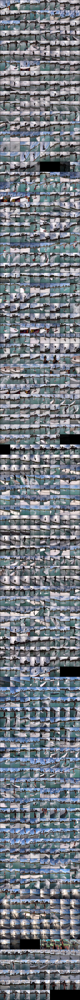

In [62]:
from IPython.display import Image
Image(filename=f'{WORKING_DIR}{video_name}-preview.png') 

## Upload extracted frames to S3 
The above script extracts every single frame from the video into the working directory. We may not want to have every frame labeled by Ground Truth workers, however, it's good to store a copy of all the frames into S3 for future use

In [63]:
!aws s3 sync $WORKING_DIR/$video_name s3://$OUTPUT_S3_BUCKET/frames/ --quiet

## Build a labeling manifest file for SageMaker Ground Truth

To train a machine learning model you need large, high-quality, labeled datasets. Labeling for thousands of images can become tedious and time consuming. Thankfully, SageMaker Ground Truth (https://aws.amazon.com/sagemaker/groundtruth/) makes it very easy to pay someone to do it for you! The Ground Truth service offers easy access to public and private human labelers and provides them with built-in workflows and interfaces for common labeling tasks, including drawing bounding boxes for object detection. 

When creating a labeling job in Ground Truth, you create a manifest file pointing to the locations of the input images stored in S3 that you want annotated. Note that each line corresponds to a single image and is an independent JSON document. 


### Time to decide how many images we're going to send to Ground Truth for labeling.

We need to establish what our sample rate is going to be from the total images captured so,
> 1.   From the total amount of frames we captured (In the step above the thumbnail)
1.   Take those frames and divide by the number of images you intend to label. (round up to whole number)

e.g - I want to feed a model with 300 quality images, and I have 5100 frames available. thus: __300 / 5100 = 17__ 

### Specify the S3 location of the frames you have extracted in the previous step: 

In [64]:
S3_BUCKET = OUTPUT_S3_BUCKET
S3_KEY_PREFIX = 'frames/'
SAMPLING_RATE = 66 # <----- is where to enter your desired sample rate

In [65]:
%%time
%run ./02_generate_gt_manifest.py -b $S3_BUCKET -k $S3_KEY_PREFIX -d $WORKING_DIR -r $SAMPLING_RATE

INFO:__main__:storing files at: tmp/
INFO:__main__:arguments:
INFO:__main__:{'frames_s3_prefix': 'frames/', 'frames_s3_bucket': 'cvml-sagemaker-repo', 'sampling_rate': '66', 'working_directory': 'tmp/'}
INFO:__main__:writing to manifest: tmp/frames_sampling_every_66_ground_truth_manifest.json
INFO:__main__:processed 6600 frames. 
INFO:__main__:took     8.8447 seconds for 100
INFO:__main__:processed 13200 frames. 
INFO:__main__:took     8.3844 seconds for 100
INFO:__main__:298 will be sent to ground truth out of 19701
INFO:__main__:Generated ground truth manifest: tmp/frames_sampling_every_66_ground_truth_manifest.json


CPU times: user 3.8 s, sys: 38.8 ms, total: 3.84 s
Wall time: 24.1 s


In [66]:
!ls -al $WORKING_DIR/

total 22808
drwxrwxr-x 3 ec2-user ec2-user     4096 Mar 12 19:33 .
drwxrwxr-x 5 ec2-user ec2-user     4096 Mar 12 19:31 ..
-rw-rw-r-- 1 ec2-user ec2-user    22052 Mar 12 19:34 frames_sampling_every_66_ground_truth_manifest.json
drwxrwxr-x 2 ec2-user ec2-user   937984 Mar 12 19:20 wakeboarding
-rw-rw-r-- 1 ec2-user ec2-user 22381765 Mar 12 19:22 wakeboarding-preview.png


In [69]:
MANIFEST_NAME = 'frames_sampling_every_{}_ground_truth_manifest.json'.format(SAMPLING_RATE) # 

If you want to view a sample of your manifest file:

In [70]:
!head $WORKING_DIR/$MANIFEST_NAME

{"source-ref": "s3://cvml-sagemaker-repo/frames/wakeboarding_000065.jpg"}
{"source-ref": "s3://cvml-sagemaker-repo/frames/wakeboarding_000131.jpg"}
{"source-ref": "s3://cvml-sagemaker-repo/frames/wakeboarding_000197.jpg"}
{"source-ref": "s3://cvml-sagemaker-repo/frames/wakeboarding_000263.jpg"}
{"source-ref": "s3://cvml-sagemaker-repo/frames/wakeboarding_000329.jpg"}
{"source-ref": "s3://cvml-sagemaker-repo/frames/wakeboarding_000395.jpg"}
{"source-ref": "s3://cvml-sagemaker-repo/frames/wakeboarding_000461.jpg"}
{"source-ref": "s3://cvml-sagemaker-repo/frames/wakeboarding_000527.jpg"}
{"source-ref": "s3://cvml-sagemaker-repo/frames/wakeboarding_000593.jpg"}
{"source-ref": "s3://cvml-sagemaker-repo/frames/wakeboarding_000659.jpg"}


## Upload the labeling manifest to S3

In [71]:
!aws s3 cp $WORKING_DIR/frames_sampling_every_5_ground_truth_manifest.json s3://$OUTPUT_S3_BUCKET/ground_truth/

upload: tmp/frames_sampling_every_66_ground_truth_manifest.json to s3://cvml-sagemaker-repo/ground_truth/frames_sampling_every_66_ground_truth_manifest.json


### OPTIONAL: Review the content of the manifest before submitting to Ground Truth

Use the `03_visualize_gt_labeling_manifest.py` script to generate a visualization of **all images included in the manifest** 

In [72]:
S3_BUCKET=OUTPUT_S3_BUCKET
IMAGE_DIRECTORY= WORKING_DIR + video_name # this is an optional parameter. since we have the extracted frames still on local disk, including this will skip downloading frames from s3

In [75]:
%run ./03_visualize_gt_labeling_manifest.py -b $S3_BUCKET -k ground_truth/$MANIFEST_NAME -i $IMAGE_DIRECTORY


INFO:__main__:manifest: s3://cvml-sagemaker-repo/ground_truth/frames_sampling_every_66_ground_truth_manifest.json
/home/ec2-user/anaconda3/envs/python3/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
INFO:__main__:sampled 298 frames
INFO:__main__:saving preview to ./frames_sampling_every_66_ground_truth_manifest_preview.png 
INFO:__main__:uploaded preview image to previews/gt-labeling-manifest/./frames_sampling_every_66_ground_truth_manifest_preview.png
INFO:__main__:processed ground_truth/frames_sampling_every_66_ground_truth_manifest.json for    24.0894 seconds.


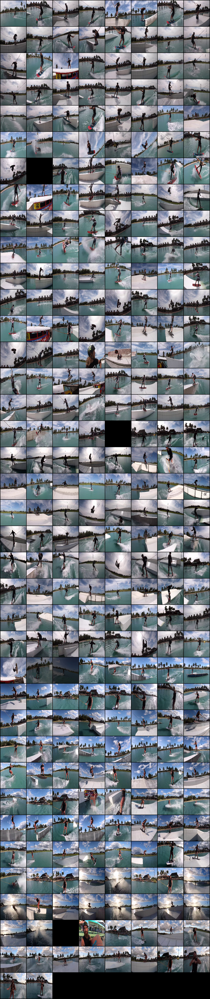

In [76]:
from IPython.display import Image
Image(filename='frames_sampling_every_{}_ground_truth_manifest_preview.png'.format(SAMPLING_RATE)) 

## Create a data labeling job in SageMaker Ground Truth

If you have never used Ground Truth before, i suggest following this blog post to create your first data labeling job in the AWS Console:
https://aws.amazon.com/blogs/aws/amazon-sagemaker-ground-truth-build-highly-accurate-datasets-and-reduce-labeling-costs-by-up-to-70/

#### TODO: Rather than reference another related lesson, I think we'll probably want to continue this effort under the context of the current scenario. At present, I have been walking through creating a workforce, referencing the dataset (from the manifest above), and labeling Job. The notebook picks up after the job has been completed. 

Done with all labeling activities in Ground Truth?  [Prepare for Training](../training/02_Sagemaker_Training_Prep_TF.ipynb).